In [1]:
import os
import heapq
import numpy as np
from warnings import warn
import scipy.spatial as spatial
import matplotlib.pyplot as plt
from bresenham import bresenham
from sklearn.neighbors import NearestNeighbors

In [2]:
def read_pgm(pgmf):
    with open( pgmf, 'rb' ) as f:
        """Return a raster of integers from a PGM as a list of lists."""
        header =  f.readline()
        print( header[0], header[1] )
        assert header == b'P5\n'
        while True:
            l = f.readline()
            if not l[0] == 35:   # skip any header comment lines
                break
        (width, height) = [int(i) for i in l.split()]
        depth = int(f.readline())
        assert depth <= 255

        raster = []
        for y in range(height):
            row = []
            for y in range(width):
                row.append(ord(f.read(1)))
            raster.append(row)

    return raster

r = read_pgm( '{}/sim_map.pgm'.format(os.getcwd()) )
b = np.flip(np.asarray(r),0)


80 53


# Sampling

This step involved sampling the environment, and ensures that both the start and waypoints are included as sampled _nodes_.

In [3]:
# Waypoints
start = np.array([95,5])
waypoint = np.array([[70,15],[90,50],[30,95],[5,50]])

sample_nbr = 300


In [4]:
samples = np.zeros(b.shape)
# Ensuring the start and goals coordinates are in the list of points
samples[start[0], start[1]] = 1

index = 0
for wp in waypoint:
    # Changing mapping due to numpy plotting behaviour
    wp[1] = b.shape[1]-wp[1]
    waypoint[index] = [wp[1],wp[0]]
    index += 1
    samples[wp[0], wp[1]] = 1

for _ in np.arange(sample_nbr):
    i = np.random.randint(b.shape[0])
    j = np.random.randint(b.shape[1])
    samples[i][j] = 1

valid_samples = np.logical_and(b,samples).astype(int)

# Finding the Nearest Nodes

This step searches for N nearest neighbours to the current node.

_Note_: The algorithm used to search for paths is A star; for it to work well there needs to be either many sampled points and/or nodes must be connected to their parent nodes.

Alternatively, this step may be changed to use a radius nearest neighbour search - where all neighbours within a specified radius are found. However, if the radius is too small, and there aren't many sampled points then there may not be any nearest neighbours. The search for N nearest neighbours overcomes this, but does not guarantee that the node will be connected to its parent node, since there may be N closer neighbours to the child node, than the parent.

## Potential Solutions
It may be preferential use the N nearest neighbours approach since it guarantees that nodes are connected, unless an obstacle is in the way. To overcome the problem of a child node not being connected to its parent (for the A star algorithm), the parent node can always be appended to the list of connected nodes, though this may result in duplicates if it is already in the list. This is not much of a problem, since it should not imapct performance much (just one entry). In this way, a few sampled points should be sufficient to find a path.

A simpler solution is to set the number of neighbours, N, to a sufficiently high value such that it _should_ include its parent node. However, this **does not guarantee that the parent node is connected**, for example in the case where there are many sampled points much closer than the parent.

In [5]:
ords = np.where(valid_samples==1)
ords = np.asarray(list(zip(ords[0],ords[1])))

nbrs = NearestNeighbors(n_neighbors=50, algorithm='ball_tree').fit(ords)
distances, indices = nbrs.kneighbors(ords)

obst = np.where(b == 0)
obst = np.asarray(list(zip(obst[0],obst[1])))

In [6]:
# Cleaning up the nearest neighbour list
b_star = np.ones(b.shape)

# Collision Radius for Robot
robt_dim = 5
clsn_rad = robt_dim/2
robt_pts = spatial.cKDTree(obst)

idx_cnt = 0
for index in indices:
    init_flg = True
    ind = 0
    idc_cnt = 0
    csn_cnt = 0
    for n in index:
        if init_flg:
            ind = n
            init_flg = False
        # print(ind)
        l = bresenham(ords[ind][0],ords[ind][1], ords[n][0], ords[n][1])

        # for coord in l.path:
        for coord in list(l):
            clsn = np.asarray(robt_pts.query_ball_point(coord, clsn_rad)).any()
            if clsn:
                # print('Removing Obstacle Collision Connection')
                # print('Obstacle Index: {},{}'.format(idx_cnt,idc_cnt))
                indices[idx_cnt,:][idc_cnt] = -1
                break
            b_star[coord] = 0
            # print('Added free path to map')
        idc_cnt += 1
    idx_cnt += 1

print('Done! New map with free paths created!')

Done! New map with free paths created!


# A*
Path Finding Algorithm
_Adapted from https://medium.com/@nicholas.w.swift/easy-a-star-pathfinding-7e6689c7f7b2_

In [7]:
class Node:
    """
    A node class for A* Pathfinding
    """

    def __init__(self, parent=None, position=None):
        self.parent = parent
        self.position = position

        self.g = 0
        self.h = 0
        self.f = 0

    def __eq__(self, other):
        return self.position == other.position
    
    def __repr__(self):
      return f"{self.position} - g: {self.g} h: {self.h} f: {self.f}"

    # defining less than for purposes of heap queue
    def __lt__(self, other):
      return self.f < other.f
    
    # defining greater than for purposes of heap queue
    def __gt__(self, other):
      return self.f > other.f




In [8]:
def return_path(current_node):
    path = []
    current = current_node
    while current is not None:
        path.append(current.position)
        current = current.parent
    return path[::-1]  # Return reversed path


def astar(maze, start, end, indices, ordinates):
    """
    Returns a list of tuples as a path from the given start to the given end in the given maze
    :param maze:
    :param start:
    :param end:
    :return:
    """

    # Create start and end node
    start_node = Node(None, start)
    start_node.g = start_node.h = start_node.f = 0
    end_node = Node(None, end)
    end_node.g = end_node.h = end_node.f = 0

    # Initialize both open and closed list
    open_list = []
    closed_list = []

    # Heapify the open_list and Add the start node
    heapq.heapify(open_list) 
    heapq.heappush(open_list, start_node)

    # Adding a stop condition
    outer_iterations = 0
    max_iterations = (len(maze[0]) * len(maze) // 2)

    # Loop until you find the end
    while len(open_list) > 0:
        outer_iterations += 1

        if outer_iterations > max_iterations:
          # if we hit this point return the path such as it is
          # it will not contain the destination
          warn("giving up on pathfinding too many iterations")
          return return_path(current_node)       
        
        # Get the current node
        current_node = heapq.heappop(open_list)
        closed_list.append(current_node)

        # Found the goal
        if current_node == end_node:
            return return_path(current_node)

        # Generate children
        children = []

        ind = np.where((ordinates[:,0] == current_node.position[0]) & (ordinates[:,1] == current_node.position[1]))[0]
        if ind.size:
            ind = ind[0]

        init_flg = True
        for index in indices[ind]:
            # Excluding first index, which returns a coordinate whcih is the same as the current position
            if init_flg:
                init_flg = False
            # Checking whether the connected node collides with an obstacle
            elif index != -1:
                # Get node position
                new_position = ordinates[index]
                # print(new_position)

                # Get node position
                node_position = (new_position[0], new_position[1])

                # Make sure within range
                if node_position[0] > (len(maze) - 1) or node_position[0] < 0 or node_position[1] > (len(maze[len(maze)-1]) -1) or node_position[1] < 0:
                    continue

                # Make sure walkable terrain
                if maze[node_position[0]][node_position[1]] != 0:
                    continue

                # Create new node
                new_node = Node(current_node, node_position)

                # Append
                children.append(new_node)


        # Loop through children
        for child in children:
            # Child is on the closed list
            if len([closed_child for closed_child in closed_list if closed_child == child]) > 0:
                continue

            # Create the f, g, and h values
            child.g = current_node.g + 1
            child.h = ((child.position[0] - end_node.position[0]) ** 2) + ((child.position[1] - end_node.position[1]) ** 2)
            child.f = child.g + child.h

            # Child is already in the open list
            if len([open_node for open_node in open_list if child.position == open_node.position and child.g > open_node.g]) > 0:
                continue

            # Add the child to the open list
            heapq.heappush(open_list, child)

    warn("Couldn't get a path to destination")
    return None

In [9]:
def path_plan(start=(95,5), end=(70,15), indices=indices, ordinates=ords, print_maze = True, maze = None):
    path = astar(maze, start, end, indices, ordinates)
    return np.asarray(path)

# Generating and Plotting the Path

The plot is overlaid with the nodes and the optimal path determined by A star.
Note that the path line's linewidth is increased, which may make it appear to collide with obstacles at times; this does not actually happen though.

In [10]:
def plot_figures(fig_num = 1, plt_cnct = False, plt_path = True):

    x = np.linspace(0, 100, b.shape[0])
    y = np.linspace(0, 100, b.shape[1])

    X, Y = np.meshgrid(x, y)

    plt.figure(fig_num)
    fig, ax = plt.subplots()

    plt.contourf(X, Y, b_star, 200, cmap='RdGy')
    plt.scatter(ords[:,1], ords[:,0],1, zorder=1)
    plt.scatter(start[1], start[0],color='orange',s=20, zorder=3)
    plt.scatter(waypoint[:,1], waypoint[:,0],color='orange',s=20, zorder=3)

    if plt_cnct:
        for index in indices:
            ind = 0
            init_flg = True
            for n in index:
                if init_flg:
                    ind = n
                    init_flg = False
                if n != -1:
                    plt.plot([ords[:,1][ind], ords[:,1][n]], [ords[:,0][ind], ords[:,0][n]], 'b-', linewidth=1, zorder=2)

    if path.any() and plt_path:
        plt.plot(path[:,1], path[:,0], 'g-', linewidth=4, zorder=2)

    plt.show()

In [11]:
b_star = np.logical_not(b).astype(int)
path = path_plan(print_maze=True, maze=b_star, start=(start[0],start[1]), end=(waypoint[0][0],waypoint[0][1]), indices=indices, ordinates=ords)

if not path.any():
    print('None')

<Figure size 432x288 with 0 Axes>

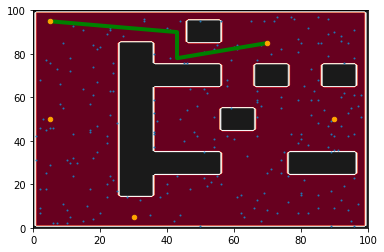

In [12]:
plot_figures(fig_num = 1)

In [13]:
b_star = np.logical_not(b).astype(int)
local_path = path_plan(print_maze=True, maze=b_star, start=(waypoint[0][0],waypoint[0][1]), end=(waypoint[1][0],waypoint[1][1]), indices=indices, ordinates=ords)

if local_path.any():
    path = np.append(path, local_path, axis=0)
else:
    print('None')

<Figure size 432x288 with 0 Axes>

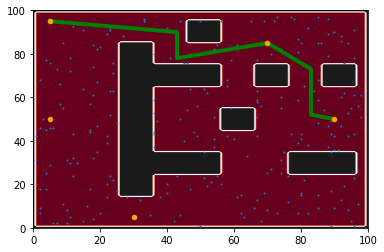

In [14]:
plot_figures(fig_num = 2)

In [15]:
b_star = np.logical_not(b).astype(int)
local_path = path_plan(print_maze=True, maze=b_star, start=(waypoint[1][0],waypoint[1][1]), end=(waypoint[2][0],waypoint[2][1]), indices=indices, ordinates=ords)

if local_path.any():
    path = np.append(path, local_path, axis=0)
else:
    print('None')

<Figure size 432x288 with 0 Axes>

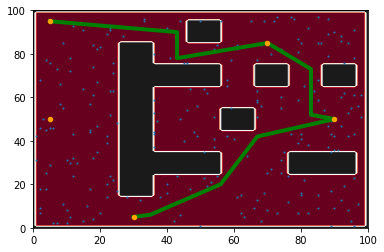

In [16]:
plot_figures(fig_num = 3)

In [17]:
b_star = np.logical_not(b).astype(int)
local_path = path_plan(print_maze=True, maze=b_star, start=(waypoint[2][0],waypoint[2][1]), end=(waypoint[3][0],waypoint[3][1]), indices=indices, ordinates=ords)

if local_path.any():
    path = np.append(path, local_path, axis=0)
else:
    print('None')

<Figure size 432x288 with 0 Axes>

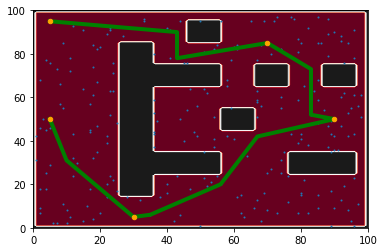

In [18]:
plot_figures(fig_num = 4)

<Figure size 432x288 with 0 Axes>

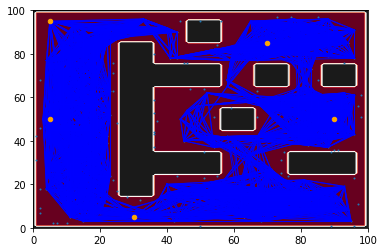

In [19]:
plot_figures(fig_num=5, plt_cnct=True, plt_path=False)